The dataset remains imbalanced; in this notebook, this issue is addressed through sampling and data augmentation techniques.

In [1]:
import pandas as pd
import numpy as np
from sklearn.utils import resample
import matplotlib.pyplot as plt

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
pd.set_option('display.width', 500)

In [2]:
def visualization_distribution_pie_chart(dataframe, column):
    column_distribution = dataframe[column].value_counts()
    
    plt.figure(figsize=(8, 8))
    plt.pie(
        column_distribution,
        labels=column_distribution.index,
        autopct=lambda pct: f"{pct:.1f}%\n({int(pct * column_distribution.sum() / 100)})",
        startangle=90,
        colors=['blue', 'red'],
        textprops={'color': 'white'}
    )
    
    plt.title("Distribution of " + column)
    
    distribution_text = "\n".join([f"{label}: {count} ({(count / column_distribution.sum() * 100):.1f}%)"
                                   for label, count in column_distribution.items()])
    plt.figtext(0.5, -0.1, distribution_text, ha="center", fontsize=10, bbox={"facecolor": "lightgrey", "alpha": 0.5, "pad": 5})
    
    plt.show()

## Sampling

In [3]:
df_train_readout = pd.read_csv('labels_increased_and_selected_and_filled_train_operational_readouts.csv')
df_train_labels = pd.read_csv('labels_increased_and_selected_and_filled_train_labels.csv')

In [7]:
df_train_readout.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1200552 entries, 0 to 1200551
Data columns (total 63 columns):
 #   Column      Non-Null Count    Dtype  
---  ------      --------------    -----  
 0   vehicle_id  1200552 non-null  int64  
 1   time_step   1200552 non-null  float64
 2   171_0       1200552 non-null  float64
 3   666_0       1200552 non-null  float64
 4   837_0       1200552 non-null  float64
 5   167_0       1200552 non-null  float64
 6   167_1       1200552 non-null  float64
 7   167_2       1200552 non-null  float64
 8   167_3       1200552 non-null  float64
 9   167_4       1200552 non-null  float64
 10  167_6       1200552 non-null  float64
 11  167_7       1200552 non-null  float64
 12  167_8       1200552 non-null  float64
 13  167_9       1200552 non-null  float64
 14  309_0       1200552 non-null  float64
 15  272_2       1200552 non-null  float64
 16  272_3       1200552 non-null  float64
 17  272_5       1200552 non-null  float64
 18  272_6       1200552 no

In [4]:
# Filter by class labels
class_0 = df_train_labels[df_train_labels['class_labels'] == 0]
class_1_to_4 = df_train_labels[df_train_labels['class_labels'] != 0]

# Randomly sample 2150 rows from class_0
class_0_sampled = resample(class_0, n_samples=4000, random_state=42, replace=False)

# Combine the sampled class_0 rows with class_1_to_4 rows
filtered_labels_df = pd.concat([class_0_sampled, class_1_to_4])

# Filter the measurements dataframe based on the selected vehicle_ids
selected_vehicle_ids = filtered_labels_df['vehicle_id']
filtered_measurements_df = df_train_readout[df_train_readout['vehicle_id'].isin(selected_vehicle_ids)]

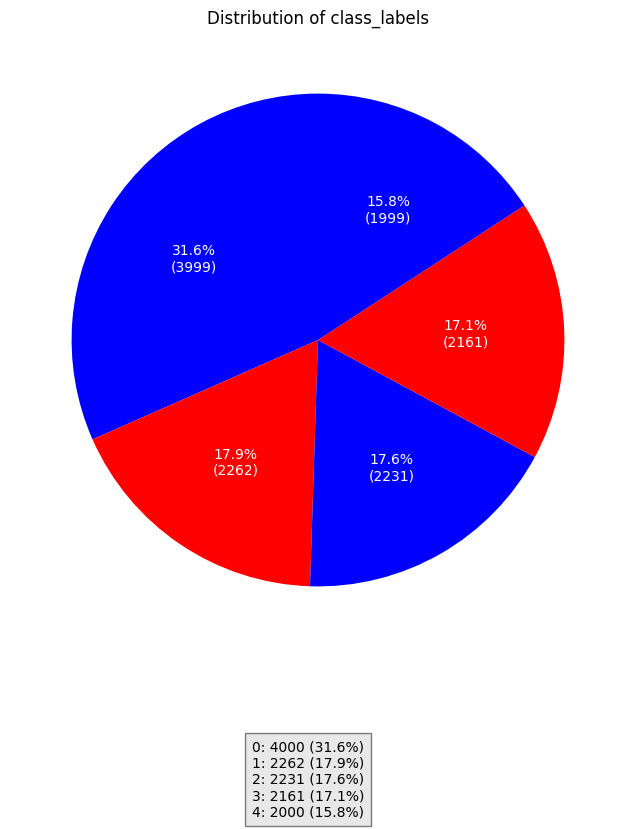

In [5]:
visualization_distribution_pie_chart(filtered_labels_df, 'class_labels')

In [13]:
filtered_measurements_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 463686 entries, 417 to 1200551
Data columns (total 63 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   vehicle_id  463686 non-null  int64  
 1   time_step   463686 non-null  float64
 2   171_0       463686 non-null  float64
 3   666_0       463686 non-null  float64
 4   837_0       463686 non-null  float64
 5   167_0       463686 non-null  float64
 6   167_1       463686 non-null  float64
 7   167_2       463686 non-null  float64
 8   167_3       463686 non-null  float64
 9   167_4       463686 non-null  float64
 10  167_6       463686 non-null  float64
 11  167_7       463686 non-null  float64
 12  167_8       463686 non-null  float64
 13  167_9       463686 non-null  float64
 14  309_0       463686 non-null  float64
 15  272_2       463686 non-null  float64
 16  272_3       463686 non-null  float64
 17  272_5       463686 non-null  float64
 18  272_6       463686 non-null  float64
 19  272_

In [6]:
# Checking for id mismatch
filtered_measurements_df['vehicle_id'].nunique()

12654

In [7]:
filtered_labels_df['vehicle_id'].nunique()

12654

In [8]:
len(filtered_labels_df['vehicle_id'])

12654

In [9]:
df_train_labels['vehicle_id'].nunique()

29941

In [10]:
len(df_train_labels['vehicle_id'])

29941

In [11]:
filtered_labels_df[filtered_labels_df['class_labels'] == 0]['vehicle_id'].nunique()

4000

In [12]:
len(filtered_labels_df[filtered_labels_df['class_labels'] == 0]['vehicle_id'])

4000

In [13]:
filtered_measurements_df.head(4000)

,vehicle_id,time_step,171_0,666_0,837_0,167_0,167_1,167_2,167_3,167_4,167_6,167_7,167_8,167_9,309_0,272_2,272_3,272_5,272_6,272_7,272_8,272_9,370_0,291_0,291_3,291_4,291_5,158_0,158_9,100_0,459_0,459_1,459_2,459_13,459_14,459_15,459_16,459_17,459_18,459_19,397_0,397_3,397_4,397_5,397_6,397_7,397_8,397_9,397_10,397_11,397_12,397_15,397_17,397_18,397_22,397_23,397_24,397_25,397_27,397_30,397_31,397_34,397_35
238,4,3.8,210915.0,21371.0,9560.0,5916.0,6412403.0,13492721.0,8467795.0,24671682.0,20782205.0,2736923.0,164019.0,53879.0,266.0,331760.0,636077.0,831675.0,3159.0,0.0,0.0,0.0,0.0,1599.0,1221.0,663.0,372.0,147456.0,1287361.0,1373990.0,321.305167,203.614250,288.045583,1650.392500,2011.951000,1703.003167,2.729389,0.108861,0.000000,0.000000,614549.0,56161.0,39554.0,7992.0,698528.0,165572.0,234481.0,25360.0,8493.0,292.0,74737.0,32396.0,248.0,24018.0,10538.0,176.0,10317.0,83399.0,29329.0,1305.0,143769.0,44692.0,712.0
239,4,45.0,266085.0,24052.0,11696.0,5916.0,6412403.0,13492721.0,8467795.0,24671682.0,20782205.0,2736923.0,164019.0,53879.0,322.0,396942.0,753259.0,1073605.0,4459.0,0.0,0.0,0.0,0.0,1930.0,1479.0,792.0,423.0,205189.0,1402225.0,1631175.0,390.695306,240.717667,335.431833,1856.624028,2450.779639,2674.143000,4.988611,0.338389,0.023444,0.020750,692173.0,71385.0,48495.0,9532.0,862685.0,197768.0,377139.0,30106.0,11039.0,356.0,91734.0,36620.0,324.0,29019.0,12807.0,228.0,12329.0,96456.0,32761.0,1573.0,159273.0,49065.0,920.0
240,4,46.4,272055.0,24080.0,11697.0,5916.0,6412403.0,13492721.0,8467795.0,24671682.0,20782205.0,2736923.0,164019.0,53879.0,322.0,398099.0,757055.0,1074736.0,4459.0,0.0,0.0,0.0,0.0,1978.0,1515.0,798.0,423.0,207205.0,1402825.0,1715175.0,409.708972,242.472806,336.491167,1861.023778,2458.139028,2853.290694,5.027250,0.339611,0.023444,0.020750,697825.0,71578.0,48520.0,9533.0,921649.0,200064.0,410303.0,30195.0,11060.0,360.0,97807.0,36632.0,328.0,29268.0,12808.0,232.0,12414.0,96628.0,32765.0,1577.0,159310.0,49065.0,921.0
241,4,57.6,277560.0,24115.0,11705.0,5916.0,6412403.0,13492721.0,8467795.0,24671682.0,20782205.0,2736923.0,164019.0,53879.0,323.0,426686.0,791830.0,1074853.0,4459.0,0.0,0.0,0.0,0.0,2047.0,1581.0,831.0,423.0,208921.0,1402969.0,1794860.0,440.186083,246.376639,339.159972,1873.357972,2518.817028,2888.310972,5.094472,0.353194,0.057111,0.020750,704650.0,72054.0,48537.0,9533.0,968965.0,209749.0,442691.0,31031.0,11157.0,360.0,107467.0,36864.0,328.0,30228.0,12824.0,233.0,12543.0,97056.0,32773.0,1582.0,159375.0,49066.0,921.0
242,4,57.8,278070.0,24115.0,11705.0,5916.0,6412403.0,13492721.0,8467795.0,24671682.0,20782205.0,2736923.0,164019.0,53879.0,323.0,430885.0,799552.0,1074853.0,4459.0,0.0,0.0,0.0,0.0,2047.0,1581.0,831.0,423.0,209329.0,1402981.0,1811175.0,444.637861,247.515639,339.223500,1877.196611,2519.724667,2888.310972,5.094472,0.353194,0.057111,0.020750,706174.0,72164.0,48794.0,9533.0,981009.0,210965.0,444320.0,31048.0,11162.0,360.0,107812.0,36872.0,329.0,30281.0,12824.0,233.0,12567.0,97168.0,32773.0,1583.0,159379.0,49066.0,921.0
243,4,60.4,296130.0,24570.0,12369.0,5916.0,6412403.0,13492721.0,8467795.0,24671682.0,20782205.0,2736923.0,164019.0,53879.0,324.0,467480.0,844181.0,1083810.0,4459.0,0.0,0.0,0.0,0.0,2152.0,1635.0,840.0,433.0,216661.0,1431758.0,1899945.0,464.333278,251.017056,343.528472,1892.906361,2542.242944,3595.302194,5.548028,0.376472,0.057111,0.020750,740220.0,96612.0,49074.0,9533.0,1019714.0,216514.0,447836.0,70545.0,11323.0,364.0,110492.0,108132.0,329.0,30862.0,12909.0,241.0,12673.0,98368.0,39798.0,1603.0,159761.0,49694.0,921.0
244,4,70.4,661530.0,38031.0,20657.0,5916.0,6412403.0,13492721.0,8467795.0,24671682.0,20782205.0,2736923.0,164019.0,53879.0,366.0,1202565.0,2247453.0,1379898.0,4459.0,0.0,0.0,0.0,0.0,4417.0,2991.0,1233.0,871.0,374557.0,1973006.0,3484605.0,730.469306,326.249333,425.426250,2470.942000,3872.725389,16147.552417,15.031972,0.853444,0.057111,0.020750,1867009.0,500200.0,54087.0,9573.0,1313063.0,370431.0,634328.0,755542.0,14279.0,428.0,138261.0,1258728.0,357.0,40252.0,14894.0,276.

In [14]:
filtered_labels_df.sort_values(by="vehicle_id")

,vehicle_id,length_of_study_time_step,in_study_repair,class_labels
3,4,210.0,0,0
6,13,155.4,0,0
10,22,190.8,1,4
13,27,354.6,1,4
15,29,425.2,1,4
20,35,167.2,0,0
34,52,235.0,1,4
35,53,128.2,0,0
38,56,396.2,0,0
39,57,436.2,0,0


In [16]:
len(df_train_labels['vehicle_id'])

29941

In [17]:
import pandas as pd

def find_different_vehicle_ids(df1, df2):
    """
    İki DataFrame'in 'vehicle_id' kolonundaki farklı değerleri bulur.
    
    Args:
    df1 (pd.DataFrame): İlk DataFrame.
    df2 (pd.DataFrame): İkinci DataFrame.
    
    Returns:
    pd.DataFrame: Sadece farklı 'vehicle_id' değerlerini içeren DataFrame.
    """
    ids_df1 = set(df1['vehicle_id'])
    ids_df2 = set(df2['vehicle_id'])
    
    different_ids = ids_df1.symmetric_difference(ids_df2)  # Set farkını al
    
    return pd.DataFrame(list(different_ids), columns=['vehicle_id'])

result = find_different_vehicle_ids(filtered_measurements_df, filtered_labels_df)
print(result)


Empty DataFrame
Columns: [vehicle_id]
Index: []


In [16]:
filtered_labels_df = filtered_labels_df.sort_values(by="vehicle_id")

In [18]:
filtered_labels_df.to_csv('balanced_labels_increased_and_selected_and_filled_train_labels.csv', index=False)
print("Başarılı")

Başarılı


In [19]:
filtered_measurements_df.to_csv('balanced_labels_increased_and_selected_and_filled_train_operational_readouts.csv', index=False)
print("Başarılı")

Başarılı


## Augmention

In [2]:
readouts_df = pd.read_csv('balanced_labels_increased_and_selected_and_filled_train_operational_readouts.csv')
labels_df = pd.read_csv('balanced_labels_increased_and_selected_and_filled_train_labels.csv')

class_distribution = labels_df['class_labels'].value_counts()

In [3]:
class_distribution

class_labels
0    4000
1    2262
2    2231
3    2161
4    2000
Name: count, dtype: int64

In [4]:
# Define the target count for each class
target_count = 4000

new_labels = []
new_readouts = []

# Start vehicle_id for new entries at 41000
new_vehicle_id_start = 41000

# Standard deviation for noise
noise_std = 0.01

In [5]:
# With noise
for class_label in [1, 2, 3, 4]:   
    current_count = class_distribution[class_label]
    samples_needed = target_count - current_count

    class_vehicle_ids = labels_df[labels_df['class_labels'] == class_label]['vehicle_id'].tolist()
    class_readouts = readouts_df[readouts_df['vehicle_id'].isin(class_vehicle_ids)]

    if samples_needed > len(class_vehicle_ids):
        raise ValueError(f"Not enough unique vehicle_ids available for class {class_label}.")
    
    selected_vehicle_ids = np.random.choice(
        class_vehicle_ids, size=samples_needed, replace=False
    )

    for new_id, old_id in enumerate(selected_vehicle_ids, start=new_vehicle_id_start):
        old_readouts = class_readouts[class_readouts['vehicle_id'] == old_id]
        noisy_readouts = old_readouts.copy()
        
        sensor_columns = noisy_readouts.columns.difference(['vehicle_id', 'time_step'])
        noisy_readouts[sensor_columns] += np.random.normal(
            loc=0, scale=noise_std, size=noisy_readouts[sensor_columns].shape
        )
        
        noisy_readouts['vehicle_id'] = new_id
        new_readouts.append(noisy_readouts)
        
        old_label = labels_df[labels_df['vehicle_id'] == old_id].iloc[0]
        new_labels.append({
            'vehicle_id': new_id,
            'length_of_study_time_step': old_label['length_of_study_time_step'],
            'in_study_repair': old_label['in_study_repair'],
            'class_labels': class_label
        })

    new_vehicle_id_start += samples_needed

In [ ]:
# Without noise
for class_label in [1, 2, 3, 4]:   
    current_count = class_distribution[class_label]
    samples_needed = target_count - current_count

    class_vehicle_ids = labels_df[labels_df['class_labels'] == class_label]['vehicle_id'].tolist()
    class_readouts = readouts_df[readouts_df['vehicle_id'].isin(class_vehicle_ids)]

    if samples_needed > len(class_vehicle_ids):
        raise ValueError(f"Not enough unique vehicle_ids available for class {class_label}.")
    
    selected_vehicle_ids = np.random.choice(
        class_vehicle_ids, size=samples_needed, replace=False
    )

    for new_id, old_id in enumerate(selected_vehicle_ids, start=new_vehicle_id_start):
        old_readouts = class_readouts[class_readouts['vehicle_id'] == old_id]
        copied_readouts = old_readouts.copy()
        
        # Assign new id
        copied_readouts['vehicle_id'] = new_id
        new_readouts.append(copied_readouts)
        
        # Copy Label
        old_label = labels_df[labels_df['vehicle_id'] == old_id].iloc[0]
        new_labels.append({
            'vehicle_id': new_id,
            'length_of_study_time_step': old_label['length_of_study_time_step'],
            'in_study_repair': old_label['in_study_repair'],
            'class_labels': class_label
        })

    new_vehicle_id_start += samples_needed


In [6]:
augmented_readouts_df = pd.concat([readouts_df] + new_readouts, ignore_index=True)
augmented_labels_df = pd.concat([labels_df, pd.DataFrame(new_labels)], ignore_index=True)

In [7]:
augmented_class_distribution = augmented_labels_df['class_labels'].value_counts()
augmented_class_distribution

class_labels
0    4000
4    4000
3    4000
2    4000
1    4000
Name: count, dtype: int64

In [8]:
augmented_readouts_df.tail(5)

,vehicle_id,time_step,171_0,666_0,837_0,167_0,167_1,167_2,167_3,167_4,167_6,167_7,167_8,167_9,309_0,272_2,272_3,272_5,272_6,272_7,272_8,272_9,370_0,291_0,291_3,291_4,291_5,158_0,158_9,100_0,459_0,459_1,459_2,459_13,459_14,459_15,459_16,459_17,459_18,459_19,397_0,397_3,397_4,397_5,397_6,397_7,397_8,397_9,397_10,397_11,397_12,397_15,397_17,397_18,397_22,397_23,397_24,397_25,397_27,397_30,397_31,397_34,397_35
869294,48345,177.4,3.118935e+06,237522.999073,320021.007418,10338.004033,5.701746e+06,1.381454e+07,1.502153e+07,5.053630e+07,1.263093e+07,3.259655e+06,167917.974163,110.995212,365137.999694,7.488994e+06,1.564975e+08,2.375212e+06,173.984492,9.957695e-03,0.015535,-0.016344,-0.030843,21956.010141,16578.992746,6412.000944,2339.016275,309981.000032,1.150139e+07,1.776717e+07,4243.524838,1304.248710,1499.209343,18363.417664,31303.347151,11520.270456,25.654570,0.751590,0.094902,0.212362,9.829699e+06,4.088050e+06,1.770672e+06,204662.001773,3.273604e+06,2.094607e+06,3.299665e+06,1.758634e+06,540348.992372,7248.996342,2.661994e+06,1.807646e+06,5752.998482,265809.997896,704636.992121,8017.002959,119032.990862,560556.011695,804859.009131,25270.009336,358289.984731,2.365764e+06,22397.001449
869295,48345,185.0,3.247935e+06,244767.990361,334852.994526,10337.990612,5.837796e+06,1.433224e+07,1.561834e+07,5.255369e+07,1.314494e+07,3.385505e+06,168517.989295,111.009220,377753.015394,7.766362e+06,1.630508e+08,2.440199e+06,175.014921,-9.681338e-07,-0.006607,-0.013025,-0.012126,22897.998544,17218.022014,6766.006791,2468.002939,312429.006617,1.191031e+07,1.852459e+07,4404.355804,1357.808756,1565.278009,19095.073559,32825.821550,11524.021699,25.893287,0.764559,0.090776,0.224623,1.031308e+07,4.244643e+06,1.839652e+06,212509.991430,3.389533e+06,2.192189e+06,3.434235e+06,1.827251e+06,557200.996551,7510.004164,2.742998e+06,1.878091e+06,6010.013449,275395.004619,725846.001714,8350.009892,125033.003498,589820.000839,839910.984785,26285.986426,380841.998396,2.442724e+06,23362.011397
869296,48345,186.0,3.269355e+06,245636.004756,336037.014181,10338.016091,5.855031e+06,1.448284e+07,1.572004e+07,5.284525e+07,1.318452e+07,3.385505e+06,168517.997005,110.991351,378468.004610,7.806831e+06,1.640051e+08,2.441330e+06,175.002400,5.374457e-03,0.015372,0.006548,0.029402,23018.008367,17278.013970,6790.019936,2471.001481,313149.003250,1.194847e+07,1.861409e+07,4423.558405,1364.215680,1571.359820,19201.003109,33189.419062,11524.947032,26.127182,0.779743,0.116660,0.226538,1.038312e+07,4.248648e+06,1.840753e+06,212695.013385,3.403197e+06,2.222241e+06,3.463607e+06,1.828475e+06,557360.977738,7509.986078,2.753166e+06,1.879160e+06,6014.983300,276647.992623,725994.994457,8354.004948,125916.981454,597689.999004,842710.989030,26386.008858,388306.001081,2.443833e+06,23362.011253
869297,48345,188.4,3.307590e+06,248800.981239,340741.013400,10337.997666,5.905926e+06,1.461620e+07,1.591206e+07,5.344858e+07,1.332815e+07,3.434465e+06,168518.003806,110.998082,382779.991838,7.892384e+06,1.659487e+08,2.463014e+06,174.994767,-2.731123e-03,-0.017545,-0.006795,-0.003235,23343.002405,17532.989405,6861.998084,2498.005281,314252.994898,1.211028e+07,1.884097e+07,4471.754061,1380.419443,1590.733961,19453.266417,33657.996853,11525.961060,26.246051,0.775063,0.100370,0.232976,1.051387e+07,4.300265e+06,1.860069e+06,216418.997534,3.445846e+06,2.249818e+06,3.502944e+06,1.849920e+06,561893.007137,7619.993231,2.777330e+06,1.904240e+06,6103.982158,279440.004289,734855.015587,8489.988080,127403.004530,606432.001552,855287.994489,26706.006646,393862.029379,2.477502e+06,23686.010645
869298,48345,189.6,3.333570e+06,250503.006369,343732.997578,10337.988626,5.917822e+06,1.467980e+07,1.598475e+07,5.369680e+07,1.344220e+07,3.445220e+06,168517.990966,111.010704,385790.000137,7.921310e+06,1.670924e+08,2.470996e+06,174.989725,1.082434e-02,0.001759,0.000642,-0.012593,23492.998952,17614.013366,6915.991556,2512.996481,314553.997989,1.221186e+07,1.892415e+07,4488.510370,1388.045614,1599.594798,19608.211184,34171.408246,115

In [10]:
augmented_labels_df

,vehicle_id,length_of_study_time_step,in_study_repair,class_labels
0,4,210.0,0,0
1,13,155.4,0,0
2,22,190.8,1,4
3,27,354.6,1,4
4,29,425.2,1,4
5,35,167.2,0,0
6,52,235.0,1,4
7,53,128.2,0,0
8,56,396.2,0,0
9,57,436.2,0,0


In [9]:
augmented_labels_df['in_study_repair'] = augmented_labels_df['in_study_repair'].astype('int64')

In [11]:
augmented_labels_df['vehicle_id'].nunique()

20000

In [12]:
len(augmented_labels_df['vehicle_id'])

20000

In [13]:
import pandas as pd

def find_different_vehicle_ids(df1, df2):
    """
    İki DataFrame'in 'vehicle_id' kolonundaki farklı değerleri bulur.
    
    Args:
    df1 (pd.DataFrame): İlk DataFrame.
    df2 (pd.DataFrame): İkinci DataFrame.
    
    Returns:
    pd.DataFrame: Sadece farklı 'vehicle_id' değerlerini içeren DataFrame.
    """
    ids_df1 = set(df1['vehicle_id'])
    ids_df2 = set(df2['vehicle_id'])
    
    different_ids = ids_df1.symmetric_difference(ids_df2)  # Set farkını al
    
    return pd.DataFrame(list(different_ids), columns=['vehicle_id'])

result = find_different_vehicle_ids(augmented_labels_df, augmented_readouts_df)
print(result)


Empty DataFrame
Columns: [vehicle_id]
Index: []


In [14]:
augmented_readouts_df.to_csv('balanced4000noresample_noisy_labels_increased_and_selected_and_filled_train_operational_readouts.csv', index=False)
print("Başarılı")

Başarılı


In [15]:
augmented_labels_df.to_csv('balanced4000noresample_noisy_labels_increased_and_selected_and_filled_train_labels.csv', index=False)
print("Başarılı")

Başarılı


In [20]:
augmented_labels_df[augmented_labels_df['length_of_study_time_step'] == 190.8]

,vehicle_id,length_of_study_time_step,in_study_repair,class_labels
2,22,190.8,1,4
19,87,190.8,1,4
2388,12103,190.8,1,4
5723,29956,190.8,0,0
6262,33700,190.8,1,3
6271,33709,190.8,1,3
7112,34550,190.8,1,3
8423,35861,190.8,1,2
8432,35870,190.8,1,2
9273,36711,190.8,1,2
